In [1]:
import numpy as np
import seaborn as sns
import pandas as pd
from scipy import stats
import barnum
from pprint import pprint

from sklearn.metrics import jaccard_score

from collections import Counter

import matplotlib
import matplotlib.pyplot as plt

%config InlineBackend.figure_format = 'retina'
%matplotlib inline
# import warnings
from pprint import pprint
plt.style.use('fivethirtyeight')

In [2]:
df = pd.read_csv('./datasets/cleaned-df.csv')

In [3]:
df.head()

,order_id,price,freight_value,product_name_len,product_description_len,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,...,order_purchase_dayofweek,days_to_customer,days_to_carrier,overall_shipping_time,shipped_on_time,delivered_on_time,category,customer_name,product_name,brand_name
0,00010242fe8c5a6d1ba2dd792cb16214,58.9,13.29,58,598,4,650.0,28.0,9.0,14.0,...,2,1.2,6.4,7.6,0,1,gifts_party,Rodrigo Keefe,limit Lisa,Speed Net Electronics
1,130898c0987d1801452a8ed92a670612,55.9,17.96,58,598,4,650.0,28.0,9.0,14.0,...,2,8.4,7.0,15.4,0,1,gifts_party,Julianna Queen,limit Lisa,Speed Net Electronics
2,532ed5e14e24ae1f0d735b91524b98b9,64.9,18.33,58,598,4,650.0,28.0,9.0,14.0,...,4,12.2,5.2,17.3,0,1,gifts_party,Palmer Bankston,limit Lisa,Speed Net Electronics
3,6f8c31653edb8c83e1a739408b5ff750,58.9,16.17,58,598,4,650.0,28.0,9.0,14.0,...,1,7.1,1.0,8.1,1,1,gifts_party,Lupe Pettigrew,limit Lisa,Speed Net Electronics
4,7d19f4ef4d04461989632411b7e588b9,58.9,13.29,58,598,4,650.0,28.0,9.0,14.0,...,3,13.0,0.9,13.9,1,1,gifts_party,Genaro Cheatham,limit Lisa,Speed Net Electronics


#### Matching customers with Brands

In [4]:
seller_sales = df.apply(lambda x: list([x['customer_name'], x['brand_name']]),axis=1) 

In [5]:
#creation of a dictionary with all customers and the sellers they have purchased from
cust_brands = {}
for cust, brand in seller_sales:
    cust_brands.setdefault(cust, set()).add(brand)

In [6]:
# total number of unique customers
len(cust_brands)

91593

In [7]:
brand_per_cust = []   # list of brands purchases per customer

for k,v in cust_brands.items():
    brand_per_cust.append(len(v))

In [8]:
#creation of a dictionary with all the sellers and the customers that purchased from them
brand_cust = {}
for cust, brand in seller_sales:
    brand_cust.setdefault(brand, set()).add(cust)

In [9]:
len(brand_cust)

2904

(array([2.091e+03, 2.880e+02, 1.490e+02, 7.900e+01, 6.700e+01, 4.300e+01,
        3.000e+01, 2.800e+01, 2.300e+01, 1.200e+01, 1.100e+01, 1.100e+01,
        4.000e+00, 7.000e+00, 5.000e+00, 0.000e+00, 5.000e+00, 6.000e+00,
        5.000e+00, 2.000e+00, 2.000e+00, 4.000e+00, 4.000e+00, 1.000e+00,
        0.000e+00, 2.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 1.000e+00,
        0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        2.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

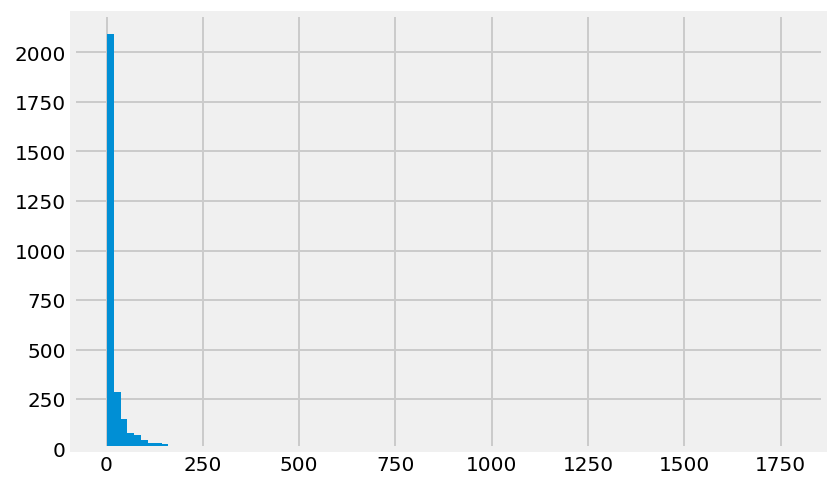

In [10]:
purchase_per_brand = []   # list of number of brand purchases

for k,v in brand_cust.items():
    purchase_per_brand.append(len(v))
plt.hist(purchase_per_brand, bins=100)

In [11]:
brand_cust

{'Speed Net Electronics': {'Adrian Mccall',
  'Alisa Smoot',
  'Allie Bigelow',
  'Alonzo Fitzsimmons',
  'Alonzo Philips',
  'Ashley Chavis',
  'Astrid Wendt',
  'Augusta Maguire',
  'Bart Olvera',
  'Bette Witte',
  'Betty Nestor',
  'Billie Millard',
  'Brandy Ware',
  'Brenda Saucedo',
  'Burl Bostic',
  'Burl Usher',
  'Calvin Clinton',
  'Caren Whitt',
  'Carla Dellinger',
  'Carol Bourne',
  'Cary Seymour',
  'Cassandra Pickett',
  'Chad Witcher',
  'Chas Knudsen',
  'Chong Trowbridge',
  'Chris Baldwin',
  'Claudio Oconnor',
  'Cliff Sears',
  'Cori Fox',
  'Corrie Fay',
  'Dario Langlois',
  'Darla Espinosa',
  'Darla Mitchel',
  'Darrell Murdock',
  'Dorene Croft',
  'Ebony Fogarty',
  'Edwin Lee',
  'Elden Eddy',
  'Elias Ramsay',
  'Elizabeth Hurst',
  'Ellis Whittle',
  'Elma Cowart',
  'Elvin Gruber',
  'Emmett Lockett',
  'Enrique Mckee',
  'Erin Atkins',
  'Eusebio Nelms',
  'Everett Olvera',
  'Fabiola Aguilar',
  'Felecia Knight',
  'Gale Bloom',
  'Garry Crisp',
  'G

#### Matching customers with products

In [12]:
prod_sales = df.apply(lambda x: list([x['customer_name'], x['product_name']]),axis=1) 

In [13]:
#creation of a dictionary with all customers and the products they have purchased
cust_prods = {}
for cust, prod in prod_sales:
    cust_prods.setdefault(cust, set()).add(prod)

In [14]:
cust_prods

{'Rodrigo Keefe': {'limit Lisa'},
 'Julianna Queen': {'limit Lisa'},
 'Palmer Bankston': {'limit Lisa'},
 'Lupe Pettigrew': {'limit Lisa'},
 'Genaro Cheatham': {'limit Lisa'},
 'Rod Nesbitt': {'limit Lisa'},
 'Jarod Morrow': {'limit Lisa'},
 'Betty Nestor': {'aunt leg', 'limit Lisa'},
 'Ellis Whittle': {'limit Lisa'},
 'Major Geer': {'archeology curler'},
 'Stan Mattos': {'archeology curler'},
 'Joseph Guerin': {'archeology curler'},
 'Jamey Cloud': {'archeology curler'},
 'Inez Beauchamp': {'archeology curler'},
 'Carla Dellinger': {'aunt leg'},
 'Chris Baldwin': {'January physician', 'aunt leg'},
 'Lavern Medley': {'rotate macrame'},
 'Caren Whitt': {'rotate macrame'},
 'Joesph Beeler': {'rotate macrame'},
 'Elden Eddy': {'rotate macrame'},
 'Tyree Lytle': {'rotate macrame'},
 'Billie Millard': {'rotate macrame'},
 'Sheri Stanfield': {'rotate macrame'},
 'Dorene Croft': {'apple lentil'},
 'Louisa Leclair': {'apple lentil'},
 'Philip Boyles': {'apple lentil'},
 'Gale Bloom': {'apple l

In [15]:
prod_sales

0                    [Rodrigo Keefe, limit Lisa]
1                   [Julianna Queen, limit Lisa]
2                  [Palmer Bankston, limit Lisa]
3                   [Lupe Pettigrew, limit Lisa]
4                  [Genaro Cheatham, limit Lisa]
5                      [Rod Nesbitt, limit Lisa]
6                     [Jarod Morrow, limit Lisa]
7                     [Betty Nestor, limit Lisa]
8                    [Ellis Whittle, limit Lisa]
9                [Major Geer, archeology curler]
10              [Stan Mattos, archeology curler]
11            [Joseph Guerin, archeology curler]
12              [Jamey Cloud, archeology curler]
13           [Inez Beauchamp, archeology curler]
14                   [Carla Dellinger, aunt leg]
15                      [Betty Nestor, aunt leg]
16                     [Chris Baldwin, aunt leg]
17               [Lavern Medley, rotate macrame]
18                 [Caren Whitt, rotate macrame]
19               [Joesph Beeler, rotate macrame]
20                  

In [16]:
purchase_per_cust = []   # list of product purchases per cust

for k,v in cust_prods.items():
    purchase_per_cust.append(len(v))

In [17]:
#creation of a dictionary with all the products and the customers that purchased them
prod_cust = {}
for cust, prod in prod_sales:
    prod_cust.setdefault(prod, set()).add(cust)

In [18]:
cust_prods

{'Rodrigo Keefe': {'limit Lisa'},
 'Julianna Queen': {'limit Lisa'},
 'Palmer Bankston': {'limit Lisa'},
 'Lupe Pettigrew': {'limit Lisa'},
 'Genaro Cheatham': {'limit Lisa'},
 'Rod Nesbitt': {'limit Lisa'},
 'Jarod Morrow': {'limit Lisa'},
 'Betty Nestor': {'aunt leg', 'limit Lisa'},
 'Ellis Whittle': {'limit Lisa'},
 'Major Geer': {'archeology curler'},
 'Stan Mattos': {'archeology curler'},
 'Joseph Guerin': {'archeology curler'},
 'Jamey Cloud': {'archeology curler'},
 'Inez Beauchamp': {'archeology curler'},
 'Carla Dellinger': {'aunt leg'},
 'Chris Baldwin': {'January physician', 'aunt leg'},
 'Lavern Medley': {'rotate macrame'},
 'Caren Whitt': {'rotate macrame'},
 'Joesph Beeler': {'rotate macrame'},
 'Elden Eddy': {'rotate macrame'},
 'Tyree Lytle': {'rotate macrame'},
 'Billie Millard': {'rotate macrame'},
 'Sheri Stanfield': {'rotate macrame'},
 'Dorene Croft': {'apple lentil'},
 'Louisa Leclair': {'apple lentil'},
 'Philip Boyles': {'apple lentil'},
 'Gale Bloom': {'apple l

In [19]:
cust_ = {k:list(cust_prods[k]) for k in list(cust_prods)}

In [20]:
cust_

{'Rodrigo Keefe': ['limit Lisa'],
 'Julianna Queen': ['limit Lisa'],
 'Palmer Bankston': ['limit Lisa'],
 'Lupe Pettigrew': ['limit Lisa'],
 'Genaro Cheatham': ['limit Lisa'],
 'Rod Nesbitt': ['limit Lisa'],
 'Jarod Morrow': ['limit Lisa'],
 'Betty Nestor': ['limit Lisa', 'aunt leg'],
 'Ellis Whittle': ['limit Lisa'],
 'Major Geer': ['archeology curler'],
 'Stan Mattos': ['archeology curler'],
 'Joseph Guerin': ['archeology curler'],
 'Jamey Cloud': ['archeology curler'],
 'Inez Beauchamp': ['archeology curler'],
 'Carla Dellinger': ['aunt leg'],
 'Chris Baldwin': ['January physician', 'aunt leg'],
 'Lavern Medley': ['rotate macrame'],
 'Caren Whitt': ['rotate macrame'],
 'Joesph Beeler': ['rotate macrame'],
 'Elden Eddy': ['rotate macrame'],
 'Tyree Lytle': ['rotate macrame'],
 'Billie Millard': ['rotate macrame'],
 'Sheri Stanfield': ['rotate macrame'],
 'Dorene Croft': ['apple lentil'],
 'Louisa Leclair': ['apple lentil'],
 'Philip Boyles': ['apple lentil'],
 'Gale Bloom': ['apple l

In [21]:
from tqdm import tqdm

In [22]:
# count vectoriser or TFIDF vectorisor

# cv.fit(all products)
# apply transfrom to each list of prodcuts

In [23]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer,TfidfVectorizer

In [24]:
prod_names = list(df.product_name.unique())

In [25]:
cv = CountVectorizer(ngram_range=(1,2),vocabulary=prod_names)

In [26]:
cv.fit(prod_names)

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
                lowercase=True, max_df=1.0, max_features=None, min_df=1,
                ngram_range=(1, 2), preprocessor=None, stop_words=None,
                strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=None,
                vocabulary=['limit Lisa', 'archeology curler', 'aunt le...
                            'segment ocean', 'grip decade', 'January physician',
                            'stop radio', 'back cowbell', 'butane crocodile',
                            'rose Abyssinian', 'broker ethernet',
                            'battery letter', 'cause hedge', 'idea meteorology',
                            'mother house', 'Brian Sagittarius', 'port captain',
                            'agreement pentagon', 'path smash', 'metal lyric',
                            'mistake year', 'sturgeon environ

In [27]:
tfidf = TfidfVectorizer(ngram_range=(1,2),vocabulary=prod_names)

In [28]:
cust_vecs = pd.Series(cust_)
cust_vecs = cust_vecs.apply(lambda x : [', '.join(x) for word in [x]][0])

In [29]:
cust_vecs

Rodrigo Keefe                          limit Lisa
Julianna Queen                         limit Lisa
Palmer Bankston                        limit Lisa
Lupe Pettigrew                         limit Lisa
Genaro Cheatham                        limit Lisa
Rod Nesbitt                            limit Lisa
Jarod Morrow                           limit Lisa
Betty Nestor                 limit Lisa, aunt leg
Ellis Whittle                          limit Lisa
Major Geer                      archeology curler
Stan Mattos                     archeology curler
Joseph Guerin                   archeology curler
Jamey Cloud                     archeology curler
Inez Beauchamp                  archeology curler
Carla Dellinger                          aunt leg
Chris Baldwin         January physician, aunt leg
Lavern Medley                      rotate macrame
Caren Whitt                        rotate macrame
Joesph Beeler                      rotate macrame
Elden Eddy                         rotate macrame


In [30]:
# user_anime = pd.crosstab(df['product_name'].iloc[0:1000], df['customer_name'].iloc[0:1000])

In [31]:
# tfidf.fit(prod_names)

In [32]:
# cust_countvecs =  pd.DataFrame(cv.transform(cust_vecs).todense(),columns=cv.get_feature_names())

In [33]:
# ((tfidf.fit_transform(cust_vecs)>0).todense()).any()

In [34]:
cust_tfidfvecs =  pd.DataFrame(tfidf.fit_transform(cust_vecs).todense(),columns=tfidf.get_feature_names())

In [35]:
cust_tfidfvecs.set_index(pd.Series(cust_).index,inplace=True)

In [36]:
# cust_['Marvin Sanches']

In [37]:
# cust_tfidfvecs.loc['Marvin Sanches',:].plot()

In [38]:
# np.sum(cust_tfidfvecs.loc['Perry Helton',:])

In [39]:
# 1/np.sqrt(2)

In [40]:
cust_tfidfvecs.head(20)

,limit Lisa,archeology curler,aunt leg,rotate macrame,apple lentil,ceramic barber,cafe advertisement,gum chronometer,segment ocean,grip decade,...,effect tent,line skin,statistic trail,squirrel paint,Taurus sky,married metal,tortellini respect,check hardboard,conga Susan,larch chair
Rodrigo Keefe,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Julianna Queen,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Palmer Bankston,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Lupe Pettigrew,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Genaro Cheatham,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Rod Nesbitt,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Jarod Morrow,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Betty Nestor,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Ellis Whittle,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Major Geer,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [41]:
from sklearn.metrics.pairwise import cosine_similarity

In [42]:
# cosine_similarity(cust_tfidfvecs)

In [43]:
from sklearn.decomposition import TruncatedSVD

In [44]:
svd = TruncatedSVD(n_components=3)

In [45]:
cust_svd = svd.fit(tfidf.fit_transform(cust_vecs)) 

In [46]:
cust_svd.components_.shape

(3, 31332)

In [47]:
cust_svds = pd.DataFrame(cust_svd.transform(cust_tfidfvecs))

In [48]:
cust_svds.columns = ['SVD1','SVD2','SVD3']

In [49]:
cust_names = list(df.customer_name.unique())

In [50]:
cust_svds['cust_names'] = cust_names

In [51]:
cust_svds.head()

,SVD1,SVD2,SVD3,cust_names
0,0.0,0.0,0.0,Rodrigo Keefe
1,0.0,0.0,0.0,Julianna Queen
2,0.0,0.0,0.0,Palmer Bankston
3,0.0,0.0,0.0,Lupe Pettigrew
4,0.0,0.0,0.0,Genaro Cheatham


In [52]:
import plotly.express as px

In [53]:
fig = px.scatter_3d(cust_svds, x='SVD1', y='SVD2', z='SVD3')
fig.show()

In [139]:
cosine_similarity(cust_svds[cust_svds.cust_names.isin(['Ronny Noriega','Gilbert Terry'])][['SVD1','SVD2','SVD3']])

array([[1., 1.],
       [1., 1.]])

In [140]:
((cosine_similarity(cust_svds[cust_svds.cust_names.isin(['Ronny Noriega','Jerrold Delong'])][['SVD1','SVD2','SVD3']]))**2).mean()

0.9960163908449623

In [141]:
cosine_similarity(cust_svds[cust_svds.cust_names.isin(['Ronny Noriega','Guy Boatwright'])][['SVD1','SVD2','SVD3']])

array([[1., 0.],
       [0., 0.]])

In [142]:
cust_svds[cust_svds.cust_names == 'Jerrold Delong'][['SVD1','SVD2','SVD3']]

,SVD1,SVD2,SVD3
7,1.036505e-11,-1.975138e-11,1.762545e-10


In [152]:
cosine_similarity(cust_svds[cust_svds.cust_names == 'Ronny Noriega'][['SVD1','SVD2','SVD3']],
                  cust_svds[cust_svds.cust_names == 'Jerrold Delong'][['SVD1','SVD2','SVD3']])[0][0]

0.996008424507506

In [164]:
cust_svds[cust_svds.cust_names == 'Ronny Noriega'].iloc[:,0:-1]

,SVD1,SVD2,SVD3
2,2.521137e-11,-8.070378e-12,3.499196e-10


In [166]:
cosine_similarity(cust_svds[cust_svds.cust_names == 'Ronny Noriega'].iloc[:,0:-1],
                  cust_svds[cust_svds.cust_names == 'Jerrold Delong'].iloc[:,0:-1])[0][0]

0.996008424507506

In [93]:
dfm[dfm.customer_name.isin(['Ronny Noriega','Gilbert Terry'])][['customer_name','SVD1','SVD2','SVD3']]

,customer_name,SVD1,SVD2,SVD3
1,Gilbert Terry,2.521137e-11,-8.070378e-12,3.499196e-10
2,Ronny Noriega,2.521137e-11,-8.070378e-12,3.499196e-10


In [117]:
from itertools import islice

In [154]:
cosine_scores = {}
for n in tqdm(cust_prods):
    cosine_scores[n] = cosine_similarity(cust_svds[cust_svds.cust_names == 'Ronny Noriega'][['SVD1','SVD2','SVD3']],
                                         cust_svds[cust_svds.cust_names == n][['SVD1','SVD2','SVD3']])[0][0]


100%|██████████| 91593/91593 [26:49<00:00, 56.92it/s]


In [155]:
cosine_scores

{'Elvia Necaise': 1.0000000000000002,
 'Gilbert Terry': 1.0000000000000002,
 'Ronny Noriega': 1.0000000000000002,
 'Alma Alicea': 1.0000000000000002,
 'Mei Olsen': 1.0000000000000002,
 'Tony Rodrigue': 1.0000000000000002,
 'Angelia Post': 1.0000000000000002,
 'Jerrold Delong': 0.996008424507506,
 'Matt Brumfield': 1.0000000000000002,
 'Guy Boatwright': 0.0,
 'Sebastian Ott': 0.0,
 'Sara Fitzgerald': 0.0,
 'Willard Hawk': 0.0,
 'Dessie Tabor': 0.0,
 'Gretchen Kahn': -0.9670328616150161,
 'Cyril Clifford': -0.9709446498289406,
 'Mia Viera': 0.0,
 'Daryl Rains': 0.0,
 'Jess Tallent': 0.0,
 'Sebastian Rhyne': 0.0,
 'Wendell Mccants': 0.0,
 'Eve Leon': 0.0,
 'Lauren Holton': 0.0,
 'Freddie Wentz': 0.9837730519424709,
 'Hillary Meredith': 0.9837730519424709,
 'Helena Pryor': 0.9837730519424709,
 'Ramon Conner': 0.9837730519424709,
 'Pierre Luster': 0.9837730519424709,
 'Dane Barney': 0.9837730519424709,
 'Pauline Copley': 0.9837730519424709,
 'Olin Saddler': 0.9837730519424709,
 'Chasity Dia

In [156]:
sorted(cosine_scores.items(), key=lambda kv: kv[1], reverse=True)

[('Elvia Necaise', 1.0000000000000002),
 ('Gilbert Terry', 1.0000000000000002),
 ('Ronny Noriega', 1.0000000000000002),
 ('Alma Alicea', 1.0000000000000002),
 ('Mei Olsen', 1.0000000000000002),
 ('Tony Rodrigue', 1.0000000000000002),
 ('Angelia Post', 1.0000000000000002),
 ('Matt Brumfield', 1.0000000000000002),
 ('Mi Mcvay', 0.9999964226396101),
 ('Curtis Mccombs', 0.9999939705162412),
 ('Harris Burrow', 0.9999898547097953),
 ('Cathleen Linn', 0.9999898359390466),
 ('Reinaldo Hardison', 0.9999867076223593),
 ('Andy Satterfield', 0.9999867076223593),
 ('Adrianne Tang', 0.9999865426289898),
 ('Geri Tharp', 0.9999859603491587),
 ('Donovan Holliman', 0.9999859603491587),
 ('Quinn Malone', 0.9999859603491587),
 ('August Goodman', 0.9999820815562538),
 ('Jamey Villa', 0.999976955219757),
 ('Charles Levine', 0.9999766452063165),
 ('Kermit Noll', 0.9999766452063165),
 ('Jerold Geiger', 0.9999766452063165),
 ('Cecil Hardison', 0.9999766452063165),
 ('Camille Glaze', 0.9999766452063165),
 ('Luc

In [157]:
weights
sorted(weights.items(), key=lambda kv: kv[1], reverse=True)

[('Elvia Necaise', 1.0),
 ('Gilbert Terry', 1.0),
 ('Ronny Noriega', 1.0),
 ('Alma Alicea', 1.0),
 ('Mei Olsen', 1.0),
 ('Tony Rodrigue', 1.0),
 ('Angelia Post', 1.0),
 ('Matt Brumfield', 1.0),
 ('Jerrold Delong', 0.25),
 ('Guy Boatwright', 0.0),
 ('Sebastian Ott', 0.0),
 ('Sara Fitzgerald', 0.0),
 ('Willard Hawk', 0.0),
 ('Dessie Tabor', 0.0),
 ('Gretchen Kahn', 0.0),
 ('Cyril Clifford', 0.0),
 ('Mia Viera', 0.0),
 ('Daryl Rains', 0.0),
 ('Jess Tallent', 0.0),
 ('Sebastian Rhyne', 0.0),
 ('Wendell Mccants', 0.0),
 ('Eve Leon', 0.0),
 ('Lauren Holton', 0.0),
 ('Freddie Wentz', 0.0),
 ('Hillary Meredith', 0.0),
 ('Helena Pryor', 0.0),
 ('Ramon Conner', 0.0),
 ('Pierre Luster', 0.0),
 ('Dane Barney', 0.0),
 ('Pauline Copley', 0.0),
 ('Olin Saddler', 0.0),
 ('Chasity Diamond', 0.0),
 ('Joelle Morehead', 0.0),
 ('Belle Penn', 0.0),
 ('Martha Cothran', 0.0),
 ('Austin Lindquist', 0.0),
 ('Chas Paul', 0.0),
 ('Johanna Baum', 0.0),
 ('Jackson Heck', 0.0),
 ('Bennie Rupp', 0.0),
 ('Shawn Amaya

In [68]:
# Create a list containing different values of components
n_comp = [n for n in range(5, 500, 50)]

# explained variance ratio for each component of Truncated SVD
explained_var_ratio = []

for x in tqdm(n_comp):
    svd = TruncatedSVD(n_components=x)
    svd.fit(cust_tfidfvecs)
    explained_var_ratio.append(svd.explained_variance_ratio_.sum())

100%|██████████| 10/10 [4:00:41<00:00, 1581.57s/it] 


In [167]:
    # Plot number of components vs explained variance
plt.plot(n_comp, explained_var_ratio)
plt.xlabel('Number of components')
plt.ylabel("Explained Variance")
plt.title("Plot of Number of components v/s explained variance")
plt.axvline(x=55, c='r',label='line at x =55')
plt.show()

NameError: name 'n_comp' is not defined

##### Now I want to try the same process with more components so that the points are more scattered

In [65]:
svd2 = TruncatedSVD(n_components=1000)

cust_svd2 = svd2.fit(tfidf.fit_transform(cust_vecs)) 

print(cust_svd2.explained_variance_ratio_.sum())
print(cust_svd2.components_.shape)

0.3855554830538705
(1000, 31332)


In [66]:
cust_svds2 = pd.DataFrame(cust_svd2.transform(cust_tfidfvecs))

In [67]:
cust_svds2 = cust_svds2.apply(lambda x: round(x,5))

In [70]:
cust_svds2['cust_names'] = cust_names

cust_svds2.head(20)

,0,1,2,3,4,5,6,7,8,9,...,991,992,993,994,995,996,997,998,999,cust_names
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Rodrigo Keefe
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Julianna Queen
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Palmer Bankston
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Lupe Pettigrew
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Genaro Cheatham
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Rod Nesbitt
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Jarod Morrow
7,0.0,-0.0,-0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,-0.00006,-0.00001,0.00003,0.00003,0.00001,0.00003,-0.00001,0.00007,0.00002,Betty Nestor
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Ellis Whittle
9,-0.0,0.0,-0.0,-0.0,0.0,-0.0,0.0,0.0,-0.0,0.0,...,-0.04435,0.00376,-0.02587,0.02038,-0.00453,0.00499,0.03046,0.00181,0.01236,Major Geer


In [194]:
cosine_similarity(cust_svds2[cust_svds2.cust_names == 'Ronny Noriega'].iloc[:,0:-1],
                  cust_svds2[cust_svds2.cust_names == 'Jerrold Delong'].iloc[:,0:-1])[0][0]

0.9978535097497987

In [71]:
cosine_scores2 = {}
for n in tqdm(cust_prods):
    cosine_scores2[n] = cosine_similarity(cust_svds2[cust_svds2.cust_names == 'Jamey Cloud'].iloc[:,0:-1],
                                         cust_svds2[cust_svds2.cust_names == n].iloc[:,0:-1])[0][0]

100%|██████████| 91593/91593 [24:46<00:00, 61.63it/s]


In [175]:
sorted(cosine_scores.items(), key=lambda kv: kv[1], reverse=True)

[('Elvia Necaise', 1.0),
 ('Gilbert Terry', 1.0),
 ('Ronny Noriega', 1.0),
 ('Alma Alicea', 1.0),
 ('Mei Olsen', 1.0),
 ('Tony Rodrigue', 1.0),
 ('Angelia Post', 1.0),
 ('Matt Brumfield', 1.0),
 ('Jerrold Delong', 0.9978542386626045),
 ('Gretchen Kahn', 0.7934612389817416),
 ('Lela Correa', 0.3097939646381728),
 ('Bernadette Brownlee', 0.30784207896856286),
 ('Kip Mcintyre', 0.30784207896856286),
 ('Rickey Seals', 0.30784207896856286),
 ('Jayson Eckert', 0.2964466689754639),
 ('Alan Hopkins', 0.2936945365020477),
 ('Omer Cobb', 0.2891492318606504),
 ('Ike Simmons', 0.2833151231328377),
 ('Marianna Mccoy', 0.27872403587176214),
 ('Carrol Piazza', 0.27760183946185385),
 ('Maria Christenson', 0.2740366010162109),
 ('Marjory Hoppe', 0.27394869688293855),
 ('Sergio Krebs', 0.2736273069218004),
 ('Naomi Benge', 0.27260336200024166),
 ('Leota Pitt', 0.27194870225575174),
 ('Ignacio Cornejo', 0.27194870225575174),
 ('Vicki Olivo', 0.27188539648275706),
 ('Dylan Mcarthur', 0.26168704132345627),

In [177]:
91593/30/24

127.21249999999999

In [ ]:
# result of previous cosine scores as a comparison of components
('Elvia Necaise', 1.0000000000000002),
 ('Gilbert Terry', 1.0000000000000002),
 ('Ronny Noriega', 1.0000000000000002),
 ('Alma Alicea', 1.0000000000000002),
 ('Mei Olsen', 1.0000000000000002),
 ('Tony Rodrigue', 1.0000000000000002),
 ('Angelia Post', 1.0000000000000002),
 ('Matt Brumfield', 1.0000000000000002),
 ('Mi Mcvay', 0.9999964226396101),
 ('Curtis Mccombs', 0.9999939705162412),
 ('Harris Burrow', 0.9999898547097953),
 ('Cathleen Linn', 0.9999898359390466),
 ('Reinaldo Hardison', 0.9999867076223593),
 ('Andy Satterfield', 0.9999867076223593),
 ('Adrianne Tang', 0.9999865426289898),
 ('Geri Tharp', 0.9999859603491587),
 ('Donovan Holliman', 0.9999859603491587),
 ('Quinn Malone', 0.9999859603491587),
 ('August Goodman', 0.9999820815562538),
 ('Jamey Villa', 0.999976955219757),
 ('Charles Levine', 0.9999766452063165),
 ('Kermit Noll', 0.9999766452063165),
 ('Jerold Geiger', 0.9999766452063165),
 ('Cecil Hardison', 0.9999766452063165),
 ('Camille Glaze', 0.9999766452063165),
 ('Lucas Enright', 0.9999766452063165)


In [72]:
cust_cosine = {}
cust_cosine['Jamey Cloud'] = cosine_scores2

In [9]:
pprint(cust_cosine)

{'Ronny Noriega': {'Alan Hopkins': 0.2936945365020477,
                   'Alma Alicea': 1.0,
                   'Angelia Post': 1.0,
                   'Bernadette Brownlee': 0.30784207896856286,
                   'Elvia Necaise': 1.0,
                   'Gilbert Terry': 1.0,
                   'Gretchen Kahn': 0.7934612389817416,
                   'Ike Simmons': 0.2833151231328377,
                   'Jayson Eckert': 0.2964466689754639,
                   'Jerrold Delong': 0.9978542386626045,
                   'Kip Mcintyre': 0.30784207896856286,
                   'Lela Correa': 0.3097939646381728,
                   'Marianna Mccoy': 0.27872403587176214,
                   'Matt Brumfield': 1.0,
                   'Mei Olsen': 1.0,
                   'Omer Cobb': 0.2891492318606504,
                   'Rickey Seals': 0.30784207896856286,
                   'Ronny Noriega': 1.0,
                   'Tony Rodrigue': 1.0}}


In [ ]:
purchase_per_prod = []   # list of number of brand purchases

for k,v in prod_cust.items():
    purchase_per_prod.append(len(v))

In [ ]:
## THEORY: create a dictionary of the weighted jaccards for each of the user pairs 
##         find the highest of these pairs(or highest few) for your chosen user and 
##         find out what they have in common and suggest the thing that they don't   

In [52]:
## Calculates the weighted distance between two sets of products based on the common products in the sets and 
## the popularity of those products within the entire dataset 

def weighted_jaccard(set1, set2):
    if len(set1) == 0 and len(set2) == 0:
        return Inf
    else:
        return float(sum((1/len(prod_cust[s]) for s in (set1&set2)))/
                     sum((1/len(prod_cust[s]) for s in (set1 | set2))))

In [54]:
weighted_jaccard({'hydrofoil instrument', 'skate armadillo'},
                 {'skate armadillo', 'undershirt girdle'})

0.6122448979591836

In [96]:
cust_prods['Ronny Noriega']

{'hydrofoil instrument'}

In [ ]:
### Use this for the creation of a dictionary of each prossible product set and their weights

In [97]:
weights = {}
for n in cust_prods:
    weights[n] = weighted_jaccard({'hydrofoil instrument'},cust_prods[n])
    

In [59]:
df_cust = df.groupby('customer_name')['product_name'].unique()

In [61]:
df_cust.head()

customer_name
Aaron Baca          [shark millimeter]
Aaron Barlow         [reading drizzle]
Aaron Berger             [hour pocket]
Aaron Buckingham       [exchange lead]
Aaron Candelaria           [beam boot]
Name: product_name, dtype: object

In [98]:
weights
sorted(weights.items(), key=lambda kv: kv[1], reverse=True)


[('Elvia Necaise', 1.0),
 ('Gilbert Terry', 1.0),
 ('Ronny Noriega', 1.0),
 ('Alma Alicea', 1.0),
 ('Mei Olsen', 1.0),
 ('Tony Rodrigue', 1.0),
 ('Angelia Post', 1.0),
 ('Matt Brumfield', 1.0),
 ('Jerrold Delong', 0.25),
 ('Guy Boatwright', 0.0),
 ('Sebastian Ott', 0.0),
 ('Sara Fitzgerald', 0.0),
 ('Willard Hawk', 0.0),
 ('Dessie Tabor', 0.0),
 ('Gretchen Kahn', 0.0),
 ('Cyril Clifford', 0.0),
 ('Mia Viera', 0.0),
 ('Daryl Rains', 0.0),
 ('Jess Tallent', 0.0),
 ('Sebastian Rhyne', 0.0),
 ('Wendell Mccants', 0.0),
 ('Eve Leon', 0.0),
 ('Lauren Holton', 0.0),
 ('Freddie Wentz', 0.0),
 ('Hillary Meredith', 0.0),
 ('Helena Pryor', 0.0),
 ('Ramon Conner', 0.0),
 ('Pierre Luster', 0.0),
 ('Dane Barney', 0.0),
 ('Pauline Copley', 0.0),
 ('Olin Saddler', 0.0),
 ('Chasity Diamond', 0.0),
 ('Joelle Morehead', 0.0),
 ('Belle Penn', 0.0),
 ('Martha Cothran', 0.0),
 ('Austin Lindquist', 0.0),
 ('Chas Paul', 0.0),
 ('Johanna Baum', 0.0),
 ('Jackson Heck', 0.0),
 ('Bennie Rupp', 0.0),
 ('Shawn Amaya

In [66]:
cust_prods['Gretchen Kahn']

{'skate armadillo'}

In [69]:
cust_prods['Cyril Clifford']

{'skate armadillo', 'undershirt girdle'}

In [54]:
### Break up into the dictionary part and then the recommendation part separately so that the dictionary
### could be continuously added to instead


def recommend_for_prods(prods_set):
    """
    Return top five recommended products
      based on the brands in 'prods_set'.
      
    Takes a set of product names.  
    """
    #creation of a dictionary of each users weighted score against the brands set
    weights = {}
    for n in cust_prods:
        weights[n] = weighted_jaccard(prods_set, cust_prods[n])
    
    
    #sorting the weighted dictionary by the weight    
    sorted_w = sorted(weights.items(), key=lambda kv: kv[1], reverse=True) 

    
    #creation of a set so the same product doesn't get added multiple times
    unique_prods = set()
    
    for i in sorted_w:
        if i[1] == 0:
            pass
        else:
            for prod in cust_prods[i[0]]:
                    if len(unique_prods) == 5:
                        break
                    elif prod in prods_set:
                        pass
                    else:
                        unique_prods.add(prod)
                                       
    return unique_prods
    
       
    # count how many times each brand appears in the entire dataset
#     brand_freq = Counter([line[1] for line in data])
    # The strategy is:
    #   (1) Find the users most similar to the 'brands_set'.
    #   (2) Get 5 brands those users also like
    #   (3) OPTIONAL: Weight the 5 stores by most unique to least unique

#     return []

In [68]:
recommend_for_prods({'hydrofoil instrument', 'skate armadillo'})

{'undershirt girdle'}

In [72]:
def recommend_for_cust(cust_string):
    """
     Recommend items to a user that are similar 
       to the brands the user already likes
    """
    products = recommend_for_prods(cust_prods.get(cust_string, set()))
    
#     while len(products) < 5:
#         products.add()
         

    return products


In [ ]:
recommend_for_cust(new_order['customer_name'])

In [73]:
recommend_for_cust('Jerrold Delong')

{'undershirt girdle'}

In [74]:
def similar_customers(user):
    """
    Given a user name **string**, returns a pretty-print string 
      of recommendations for a user.
    """
    recs = recommend_for_cust(user)

    return "For user {user}, who likes {liked}, we recommend {recs}.".format(
        user=user,
        liked=", ".join(cust_prods.get(user, ["nothing"])),
        recs=", ".join(recs))

In [75]:
similar_customers('Jerrold Delong')

'For user Jerrold Delong, who likes skate armadillo, hydrofoil instrument, we recommend undershirt girdle.'

In [ ]:
similar_customers(new_order['customer_name'])

In [77]:
def similar_prods(prod_name):
    """
    Given a brand name **string**, returns a pretty-print string of 
        recommendations of more brands.
    """
    recs = recommend_for_prods(set([prod_name]))

    return "For a user who likes {liked}, we recommend {recs}.".format(
        liked=prod_name,
        recs=", ".join(recs))

In [78]:
similar_prods('skate armadillo')

'For a user who likes skate armadillo, we recommend undershirt girdle, hydrofoil instrument.'

In [ ]:
def get_most_similar_prods(product, max_n=5):
    # 1. Of the users who like this brand, 
    #     count how many times they like other brands.
    similar_prods = Counter([ j for i in prod_cust[product] for j in cust_prods[i]])
   
   # 2. Weight the brands to eliminate common ones such as Target. 
    weighted_prods = {k: (v/len(prod_cust[k])) for k,v in similar_prods.items()}
    
    sorted_prods = sorted(weighted_prods.items(), key=lambda kv: kv[1], reverse=True)
    
    # 3. Sort the brands by largest score and return only the names
    return [prods[0] for prods in sorted_prods[1:max_n+1]]

In [ ]:
get_most_similar_prods('plate production')

In [ ]:
import random

def get_user_recommendations(cust, max_n=5):
    final_prod_names = []
    
    for x in cust_prods[cust]:
        similar_prods = get_most_similar_prods(x, max_n=5)
        final_prod_names.extend(similar_prods)
        
    sorted_prods = sorted(Counter(final_prod_names).items(), key=lambda kv: kv[1], reverse=True) 
    
    return [prods[0] for prods in sorted_prods[1:max_n+1]]
    
    # 1. Given the brands the user likes, return the similar brands!


In [ ]:
get_user_recommendations('Jacque Gunn')

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.compose import ColumnTransformer 
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, LassoCV, SGDClassifier, LogisticRegression
from sklearn.ensemble import AdaBoostRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.feature_selection import SelectKBest, chi2 
from sklearn.decomposition import PCA, NMF, TruncatedSVD
from sklearn.metrics import r2_score, mean_squared_error, accuracy_score, classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

In [ ]:
X = df.drop(columns = ['review_score','order_id','customer_name','customer_zip_code_prefix',
                       'customer_city', 'customer_state','payment_type', 'payment_installments', 'payment_value'])
y = df['review_score']

In [ ]:
categorical_features = X.select_dtypes(include = 'object')
numerical_features = X.select_dtypes(include = ['int64','float64']).columns.to_list()
datetime_features = X.select_dtypes(include = 'datetime64[ns]').columns.to_list()

In [ ]:
categorical_features = pd.concat([categorical_features, df[['order_purchase_year', 'order_purchase_month', 'order_purchase_dayofweek']]],axis=1)

In [ ]:
numerical_features = [x for x in numerical_features if x not in ['shipped_on_time','delivered_on_time']]

In [ ]:
one_hot = OneHotEncoder(handle_unknown='ignore').fit(categorical_features)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y)

In [ ]:
y_train.value_counts(normalize=True)

In [ ]:
y_test.value_counts(normalize=True)

In [ ]:
numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                                      ('scaler', StandardScaler())])

In [ ]:
categorical_trans = Pipeline(steps=[('imputer', SimpleImputer(strategy='most_frequent')),
                                   ('onehot', one_hot)])

In [ ]:
ctrans = ColumnTransformer([('num', numeric_transformer, numerical_features),                                                            
                            ('cat', categorical_trans, categorical_features.columns),
                            ('datetime', 'drop', datetime_features)],
                             remainder = 'passthrough')

In [ ]:
Xt_train = ctrans.fit_transform(X_train)

In [ ]:
Xt_test = ctrans.transform(X_test)

In [ ]:
model4 = Pipeline([('feature selector', TruncatedSVD(n_components=115, 
                                                    n_iter=7, 
                                                    random_state=42)),
                  ('classifier', RandomForestClassifier(n_estimators=100))])

model4.fit(Xt_train, y_train)
y_pred = model4.predict(Xt_test)

print("Classification Report:")
print(classification_report(y_test, y_pred))

conmat = np.array(confusion_matrix(y_test, y_pred, labels=[1,2,3,4,5]))

confusion = pd.DataFrame(conmat, index=['is_1', 'is_2', 'is_3', 'is_4', 'is_5'],
                         columns=['pred_1','pred_2','pred_3','pred_4','pred_5'])
print("Confusion Matrix:")
confusion.head()

In [ ]:
### Given 1 purchase, find recommendations
new_order = df.iloc[7454]

In [ ]:
X_test

In [ ]:
new_order

In [ ]:
X.columns

In [ ]:
df.head()

In [ ]:
df.groupby(['category','product_name'])['review_score'].mean().sort_values(ascending=False)

In [ ]:
df[df['category'] == 'gifts_party'][['product_name','review_score']].sort_values(by='review_score',ascending=False)

In [ ]:
similar_customers(new_order['customer_name'])

In [ ]:
df[df['product_name'] == 'quotation ellipse'][['price','product_name_len', 'product_description_len',
 'product_photos_qty','product_weight_g', 'product_length_cm', 
 'product_height_cm', 'product_width_cm', 'product_category_name_english', 
 'seller_city','seller_state','category']]

In [ ]:
for product in prod_cust:
    df[df['category'] == 'gifts_party'][['product_name','review_score']].sort_values(by='review_score',ascending=False)

In [ ]:
prod_cust

In [ ]:
for n in prod_cust:
    print(n)

In [ ]:
from sklearn.metrics import jaccard_similarity_score,jaccard_score

In [ ]:
df.iloc[1].filter(regex='product|cus|cat|sell')

In [ ]:
jaccard_similarity_score(df.filter(regex='product|cus|cat|sell'),df.iloc[1].filter(regex='product|cus|cat|sell'))

In [ ]:
df.filter(regex='product|cus|cat|sell')

In [10]:
pprint(cust_cosine)

{'Ronny Noriega': {'Alan Hopkins': 0.2936945365020477,
                   'Alma Alicea': 1.0,
                   'Angelia Post': 1.0,
                   'Bernadette Brownlee': 0.30784207896856286,
                   'Elvia Necaise': 1.0,
                   'Gilbert Terry': 1.0,
                   'Gretchen Kahn': 0.7934612389817416,
                   'Ike Simmons': 0.2833151231328377,
                   'Jayson Eckert': 0.2964466689754639,
                   'Jerrold Delong': 0.9978542386626045,
                   'Kip Mcintyre': 0.30784207896856286,
                   'Lela Correa': 0.3097939646381728,
                   'Marianna Mccoy': 0.27872403587176214,
                   'Matt Brumfield': 1.0,
                   'Mei Olsen': 1.0,
                   'Omer Cobb': 0.2891492318606504,
                   'Rickey Seals': 0.30784207896856286,
                   'Ronny Noriega': 1.0,
                   'Tony Rodrigue': 1.0}}


In [88]:
sorted_ = sorted(cust_cosine['Jamey Cloud'].items(), key=lambda kv: kv[1], reverse=True)

In [96]:
sorted_[15]

('Kelly Quillen', 0.2066485977286549)

In [95]:
sorted_[15][0]

'Kelly Quillen'

In [92]:
cust_prods[]

{'beetle reading'}

In [97]:
cust_prods['Kelly Quillen']

{'beetle reading'}

In [102]:
cust_prods['Jamey Cloud']

{'archeology curler'}

In [73]:
cust_cosine 

{'Jamey Cloud': {'Rodrigo Keefe': 0.0,
  'Julianna Queen': 0.0,
  'Palmer Bankston': 0.0,
  'Lupe Pettigrew': 0.0,
  'Genaro Cheatham': 0.0,
  'Rod Nesbitt': 0.0,
  'Jarod Morrow': 0.0,
  'Betty Nestor': 0.028272565357245857,
  'Ellis Whittle': 0.0,
  'Major Geer': 1.0,
  'Stan Mattos': 1.0,
  'Joseph Guerin': 1.0,
  'Jamey Cloud': 1.0,
  'Inez Beauchamp': 1.0,
  'Carla Dellinger': 0.028272565357245857,
  'Chris Baldwin': 0.028272565357245857,
  'Lavern Medley': 0.026487896022955905,
  'Caren Whitt': 0.026487896022955905,
  'Joesph Beeler': 0.026487896022955905,
  'Elden Eddy': 0.026487896022955905,
  'Tyree Lytle': 0.026487896022955905,
  'Billie Millard': 0.026487896022955905,
  'Sheri Stanfield': 0.026487896022955905,
  'Dorene Croft': 0.0022380000014808788,
  'Louisa Leclair': 0.0022380000014808788,
  'Philip Boyles': 0.0022380000014808788,
  'Gale Bloom': 0.0022380000014808788,
  'Calvin Clinton': 0.0022380000014808788,
  'Hazel Chester': 0.0022380000014808788,
  'Taylor Westfall'

In [11]:
cust_cosine['Ronny Noriega']

{'Lela Correa': 0.3097939646381728, 'Elvia Necaise': 1.0, 'Gilbert Terry': 1.0, 'Rickey Seals': 0.30784207896856286, 'Ronny Noriega': 1.0, 'Alan Hopkins': 0.2936945365020477, 'Alma Alicea': 1.0, 'Jayson Eckert': 0.2964466689754639, 'Mei Olsen': 1.0, 'Tony Rodrigue': 1.0, 'Angelia Post': 1.0, 'Matt Brumfield': 1.0, 'Jerrold Delong': 0.9978542386626045, 'Gretchen Kahn': 0.7934612389817416, 'Bernadette Brownlee': 0.30784207896856286, 'Kip Mcintyre': 0.30784207896856286, 'Omer Cobb': 0.2891492318606504, 'Ike Simmons': 0.2833151231328377, 'Marianna Mccoy': 0.27872403587176214}

In [103]:
def recommend_for_prods2(customer, customer_dict = cust_cosine):
    """
    Return top five recommended products
      based on the brands in 'prods_set'.
      
    Takes a set of product names.  
    """
    #creation of a dictionary of each users weighted score against the brands set
    weights = cust_cosine[customer]

    
    #sorting the weighted dictionary by the weight    
    sorted_w = sorted(weights.items(), key=lambda kv: kv[1], reverse=True) 

    
    #creation of a set so the same product doesn't get added multiple times
    unique_prods = set()
    
    for i in sorted_w:
        if i[1] == 1:
            pass
        else:
            for prod in cust_prods[i[0]]:
                    if len(unique_prods) == 5:
                        break
                    elif prod in cust_prods[customer]:
                        break
                    else:
                        unique_prods.add(prod)
                                       
    return unique_prods
    

In [104]:
recommend_for_prods2('Jamey Cloud')

{'beetle reading',
 'kangaroo pump',
 'orange pea',
 'pear multimedia',
 'selection bathtub'}

In [ ]:
def recommend_for_cust2(cust_string):
    """
     Recommend items to a user that are similar 
       to the brands the user already likesa
    """
    products = recommend_for_prods2(cust_prods.get(cust_string, set()))
    
#     while len(products) < 5:
#         products.add()
         

    return products

In [ ]:
def similar_customers2(user):
    """
    Given a user name **string**, returns a pretty-print string 
      of recommendations for a user.
    """
    recs = recommend_for_cust2(user)

    return "For user {user}, who purchased {liked}, we recommend {recs}.".format(
        user=user,
        liked=", ".join(cust_prods.get(user, ["nothing"])),
        recs=", ".join(recs))

In [7]:
import plotly.express as px

In [2]:
import pandas as pd
import numpy as np

In [5]:
df2 = pd.DataFrame(np.random.randint(0,100,size=(100, 3)), columns=['SVD1','SVD2','SVD3'])

In [9]:
fig = px.scatter_3d(df2, x='SVD1', y='SVD2', z='SVD3')
fig.update_layout(scene = dict(
                    xaxis = dict(nticks = 10,
                         backgroundcolor="rgb(200, 200, 230)",
                         gridcolor="white",
                         showbackground=True,
                         zerolinecolor="white",),
                    yaxis = dict(nticks = 10,
                        backgroundcolor="rgb(230, 200,230)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white"),
                    zaxis = dict(nticks = 10,
                        backgroundcolor="rgb(230, 230,200)",
                        gridcolor="white",
                        showbackground=True,
                        zerolinecolor="white",),),
                    width=700,
                    margin=dict(
                    r=10, l=10,
                    b=10, t=10)
                  )
fig.show()

In [11]:
import gzip
import shutil
import json

In [2]:
with open('../web application/datasets/prod_cosine.json', 'rb') as f_in:
    with gzip.open('../web application/datasets/prod_cosine.json.gz', 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)

In [3]:
with open('../web application/datasets/prod_images.json', 'rb') as f_in:
    with gzip.open('../web application/datasets/prod_images.json.gz', 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)

In [15]:
with gzip.open('../web application/datasets/prod_cosine.json.gz', 'rb') as fp:
    json_bytes = fp.read()
data = json.loads(json_bytes)    

In [16]:
def combine_weights(prod_set, prod_dict = data):
            """
            Takes products and returns a dictionary with the highest similarity scores of those 
            products for each of the entire set of products
       
            Parameters:
            *args
              products in string format
      
            Returns:
            dictionary
              a dictionary of the highest similarity scores for each product 
            """
            weights = prod_dict[list(prod_set)[0]]
            for prod in list(prod_set):
                for k,v in weights.items(): 
                    if prod_dict[prod][k] > v:
                        weights[k] = prod_dict[prod][k]
                    else:
                        weights[k] = v
            return weights

In [17]:
combine_weights({'grip decade', 'back cowbell', 'aunt leg','January physician','limit Lisa'})

{'limit Lisa': 0.9999999999999998,
 'archeology curler': 0.008215328636070496,
 'aunt leg': 1.0000000000000004,
 'rotate macrame': 0.016548588211813032,
 'apple lentil': 0.009907580025131184,
 'ceramic barber': 0.006433362019971469,
 'cafe advertisement': 0.8850197499759328,
 'gum chronometer': 0.012080735240454117,
 'segment ocean': 0.015743379603568846,
 'grip decade': 0.9999999999999999,
 'January physician': 0.9999999999999998,
 'stop radio': 0.07077637918057055,
 'back cowbell': 1.0000000000000009,
 'butane crocodile': 0.043257654824653526,
 'rose Abyssinian': 0.005172991704375899,
 'broker ethernet': 0.913888216029496,
 'battery letter': -0.00334173738011034,
 'cause hedge': 0.013557642343386807,
 'idea meteorology': 0.012506388976320608,
 'mother house': 0.02464585377746211,
 'Brian Sagittarius': 0.03999130625069794,
 'port captain': 0.006773459883366012,
 'agreement pentagon': -0.011584333778437024,
 'path smash': 0.007315866584530429,
 'metal lyric': 0.012578126919260756,
 'mi